<a href="https://colab.research.google.com/github/MaddyMk05/Machine-Learning/blob/main/face_Mask_Detection_using_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install kaggle

In [1]:
# configuring the path of Kaggle.json file
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Importing Face Mask Dataset

In [2]:
# API to fetch the dataset from Kaggle
!kaggle datasets download -d omkargurav/face-mask-dataset

Dataset URL: https://www.kaggle.com/datasets/omkargurav/face-mask-dataset
License(s): unknown
 80% 130M/163M [00:00<00:00, 1.35GB/s]
100% 163M/163M [00:00<00:00, 1.22GB/s]


In [5]:
# extracting the compessed Dataset
from zipfile import ZipFile
dataset = '/content/face-mask-dataset.zip'

with ZipFile(dataset,'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [6]:
!ls

data  face-mask-dataset.zip  kaggle.json  sample_data


Importing the Dependencies

In [7]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image
from sklearn.model_selection import train_test_split

In [8]:
with_mask_files = os.listdir('/content/data/with_mask')
print(with_mask_files[0:5])
print(with_mask_files[-5:])

['with_mask_148.jpg', 'with_mask_227.jpg', 'with_mask_2164.jpg', 'with_mask_1691.jpg', 'with_mask_509.jpg']
['with_mask_1595.jpg', 'with_mask_2742.jpg', 'with_mask_1930.jpg', 'with_mask_3457.jpg', 'with_mask_3547.jpg']


In [9]:
without_mask_files = os.listdir('/content/data/without_mask')
print(without_mask_files[0:5])
print(without_mask_files[-5:])

['without_mask_667.jpg', 'without_mask_1415.jpg', 'without_mask_1949.jpg', 'without_mask_572.jpg', 'without_mask_2707.jpg']
['without_mask_1221.jpg', 'without_mask_1532.jpg', 'without_mask_1380.jpg', 'without_mask_2929.jpg', 'without_mask_747.jpg']


In [10]:
print('Number of with mask images:', len(with_mask_files))
print('Number of without mask images:', len(without_mask_files))

Number of with mask images: 3725
Number of without mask images: 3828


**Creating Labels for the two class of Images**

with mask --> 1

without mask --> 0

In [11]:
# create the labels

with_mask_labels = [1]*3725

without_mask_labels = [0]*3828

In [12]:
print(with_mask_labels[0:5])

print(without_mask_labels[0:5])

[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]


In [13]:
print(len(with_mask_labels))
print(len(without_mask_labels))

3725
3828


In [14]:
labels = with_mask_labels + without_mask_labels

print(len(labels))
print(labels[0:5])
print(labels[-5:])

7553
[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]


**Displaying the Images**

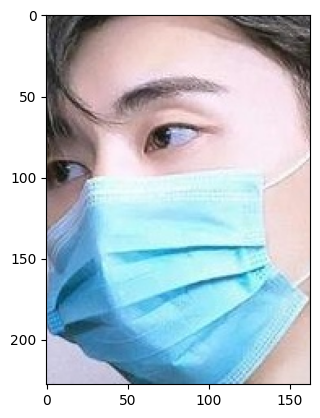

In [15]:
# displaying with mask image
img = mpimg.imread('/content/data/with_mask/with_mask_1545.jpg')
imgplot = plt.imshow(img)
plt.show()

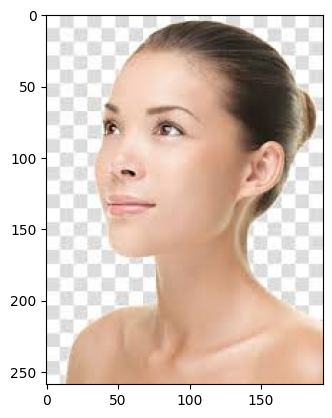

In [16]:
# displaying without mask image
img = mpimg.imread('/content/data/without_mask/without_mask_2925.jpg')
imgplot = plt.imshow(img)
plt.show()

**Image Processing**

1.Resize the Images

2.Convert the images to numpy arrays

In [18]:
# convert images to numpy arrays+

with_mask_path = '/content/data/with_mask/'

data = []

for img_file in with_mask_files:

  image = Image.open(with_mask_path + img_file)
  image = image.resize((128,128))
  image = image.convert('RGB')
  image = np.array(image)
  data.append(image)



without_mask_path = '/content/data/without_mask/'


for img_file in without_mask_files:

  image = Image.open(without_mask_path + img_file)
  image = image.resize((128,128))
  image = image.convert('RGB')
  image = np.array(image)
  data.append(image)

In [19]:
type(data)

list

In [20]:
len(data)

7553

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  1,   1,   1],
        [  5,   5,   5],
        [  7,   7,   7]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  1,   1,   1],
        ...,
        [  5,   5,   5],
        [  7,   7,   7],
        [  8,   8,   8]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  1,   1,   1],
        ...,
        [  6,   6,   6],
        [  7,   7,   7],
        [  8,   8,   8]],

       ...,

       [[ 61,  61,  61],
        [ 56,  56,  56],
        [ 48,  48,  48],
        ...,
        [176, 176, 176],
        [182, 182, 182],
        [185, 185, 185]],

       [[ 51,  51,  51],
        [ 45,  45,  45],
        [ 33,  33,  33],
        ...,
        [173, 173, 173],
        [179, 179, 179],
        [182, 182, 182]],

       [[ 33,  33,  33],
        [ 27,  27,  27],
        [ 15,  15,  15],
        ...,
        [171, 171, 171],
        [178, 178, 178],
        [181, 181, 181]]], dtype=uint8)
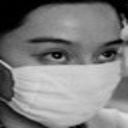

In [21]:
data[0]

In [22]:
type(data[0])

numpy.ndarray

In [23]:
data[0].shape

(128, 128, 3)

In [24]:
# converting image list and label list to numpy arrays

X = np.array(data)
Y = np.array(labels)

In [25]:
type(X)

numpy.ndarray

In [26]:
type(Y)

numpy.ndarray

In [27]:
print(X.shape)
print(Y.shape)

(7553, 128, 128, 3)
(7553,)


In [28]:
print(Y)

[1 1 1 ... 0 0 0]


**Train Test Split**

In [29]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=2)

In [30]:
print(X.shape, X_train.shape, X_test.shape)

(7553, 128, 128, 3) (6042, 128, 128, 3) (1511, 128, 128, 3)


In [31]:
# scaling the data

X_train_scaled = X_train/255

X_test_scaled = X_test/255

array([[[ 28,  28,  30],
        [ 28,  28,  30],
        [ 28,  28,  30],
        ...,
        [146, 152, 155],
        [186, 191, 194],
        [204, 209, 212]],

       [[ 28,  28,  30],
        [ 28,  28,  30],
        [ 27,  27,  29],
        ...,
        [103, 108, 111],
        [157, 162, 165],
        [206, 211, 214]],

       [[ 30,  30,  32],
        [ 29,  29,  31],
        [ 28,  28,  30],
        ...,
        [ 92,  96,  99],
        [123, 128, 131],
        [153, 158, 161]],

       ...,

       [[215, 208, 205],
        [206, 198, 195],
        [191, 181, 178],
        ...,
        [183, 180, 189],
        [183, 180, 189],
        [182, 179, 188]],

       [[212, 207, 203],
        [209, 202, 199],
        [206, 198, 194],
        ...,
        [185, 181, 191],
        [184, 181, 190],
        [184, 181, 190]],

       [[212, 207, 203],
        [209, 202, 199],
        [207, 199, 195],
        ...,
        [185, 181, 191],
        [184, 181, 190],
        [184, 181, 190]]], dtype=uint8)
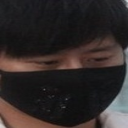

In [32]:
X_train[0]

In [33]:
X_train_scaled[0]

array([[[0.10980392, 0.10980392, 0.11764706],
        [0.10980392, 0.10980392, 0.11764706],
        [0.10980392, 0.10980392, 0.11764706],
        ...,
        [0.57254902, 0.59607843, 0.60784314],
        [0.72941176, 0.74901961, 0.76078431],
        [0.8       , 0.81960784, 0.83137255]],

       [[0.10980392, 0.10980392, 0.11764706],
        [0.10980392, 0.10980392, 0.11764706],
        [0.10588235, 0.10588235, 0.11372549],
        ...,
        [0.40392157, 0.42352941, 0.43529412],
        [0.61568627, 0.63529412, 0.64705882],
        [0.80784314, 0.82745098, 0.83921569]],

       [[0.11764706, 0.11764706, 0.1254902 ],
        [0.11372549, 0.11372549, 0.12156863],
        [0.10980392, 0.10980392, 0.11764706],
        ...,
        [0.36078431, 0.37647059, 0.38823529],
        [0.48235294, 0.50196078, 0.51372549],
        [0.6       , 0.61960784, 0.63137255]],

       ...,

       [[0.84313725, 0.81568627, 0.80392157],
        [0.80784314, 0.77647059, 0.76470588],
        [0.74901961, 0

**Building a Convolutional Neural Networks (CNN)**

In [34]:
import tensorflow as tf
from tensorflow import keras

In [35]:
num_of_classes = 2

model = keras.Sequential()

model.add(keras.layers.Conv2D(32, kernel_size=(3,3), activation='relu', input_shape=(128,128,3)))
model.add(keras.layers.MaxPooling2D(pool_size=(2,2)))


model.add(keras.layers.Conv2D(64, kernel_size=(3,3), activation='relu'))
model.add(keras.layers.MaxPooling2D(pool_size=(2,2)))

model.add(keras.layers.Flatten())

model.add(keras.layers.Dense(128, activation='relu'))
model.add(keras.layers.Dropout(0.5))

model.add(keras.layers.Dense(64, activation='relu'))
model.add(keras.layers.Dropout(0.5))


model.add(keras.layers.Dense(num_of_classes, activation='sigmoid'))

/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [36]:
# compile the neural network
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['acc'])

In [37]:
# training the neural network
history = model.fit(X_train_scaled, Y_train, validation_split=0.1, epochs=5)

Epoch 1/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 13s 42ms/step - acc: 0.6920 - loss: 0.8813 - val_acc: 0.8860 - val_loss: 0.2713
Epoch 2/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - acc: 0.8742 - loss: 0.3058 - val_acc: 0.9157 - val_loss: 0.2084
Epoch 3/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - acc: 0.9002 - loss: 0.2483 - val_acc: 0.9107 - val_loss: 0.2105
Epoch 4/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - acc: 0.9226 - loss: 0.2004 - val_acc: 0.9058 - val_loss: 0.2148
Epoch 5/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - acc: 0.9338 - loss: 0.1673 - val_acc: 0.9157 - val_loss: 0.2101


**Model Evaluation**

In [38]:
loss, accuracy = model.evaluate(X_test_scaled, Y_test)
print('Test Accuracy =', accuracy)

48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - acc: 0.9113 - loss: 0.2344
Test Accuracy = 0.9185969829559326


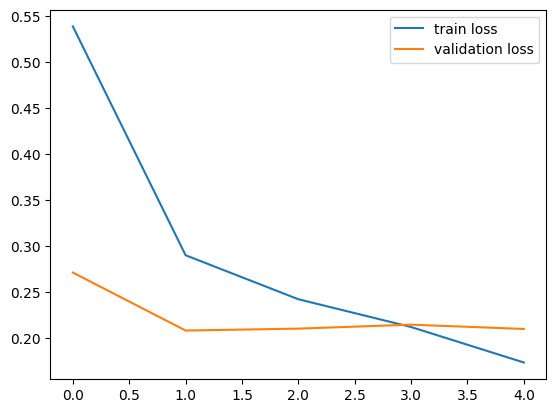

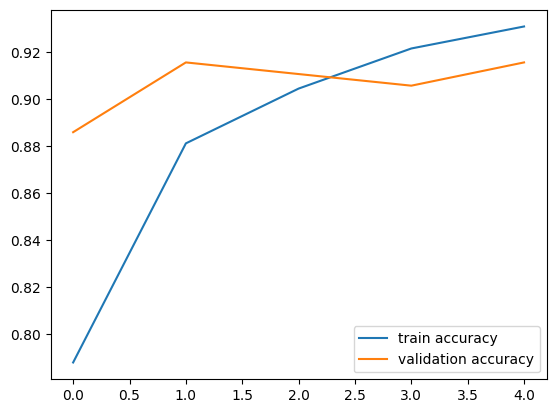

In [39]:
h = history

# plot the loss value
plt.plot(h.history['loss'], label='train loss')
plt.plot(h.history['val_loss'], label='validation loss')
plt.legend()
plt.show()

# plot the accuracy value
plt.plot(h.history['acc'], label='train accuracy')
plt.plot(h.history['val_acc'], label='validation accuracy')
plt.legend()
plt.show()

**Predictive System**

Path of the image to be predicted: /content/test no.jpg


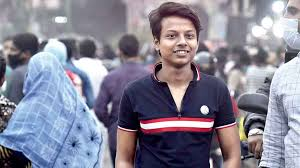

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
[[0.519569   0.48540145]]
0
The person in the image is not wearing a mask


In [44]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resized = cv2.resize(input_image, (128,128))

input_image_scaled = input_image_resized/255

input_image_reshaped = np.reshape(input_image_scaled, [1,128,128,3])

input_prediction = model.predict(input_image_reshaped)

print(input_prediction)


input_pred_label = np.argmax(input_prediction)

print(input_pred_label)


if input_pred_label == 1:

  print('The person in the image is wearing a mask')

else:

  print('The person in the image is not wearing a mask')

Path of the image to be predicted: /content/test.jpg


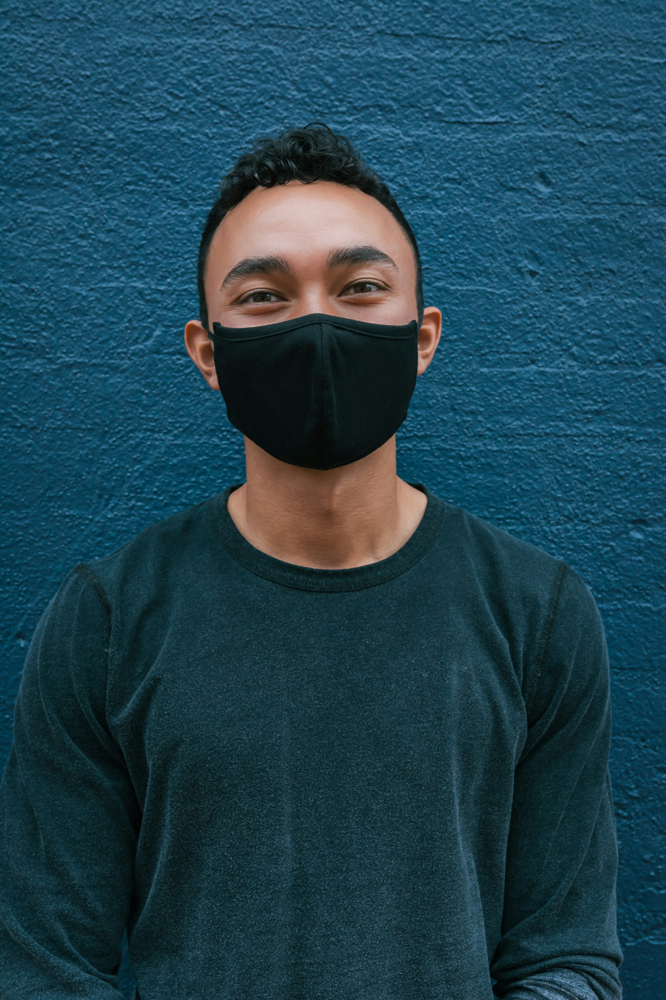

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
[[0.17423509 0.8833208 ]]
1
The person in the image is wearing a mask


In [45]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resized = cv2.resize(input_image, (128,128))

input_image_scaled = input_image_resized/255

input_image_reshaped = np.reshape(input_image_scaled, [1,128,128,3])

input_prediction = model.predict(input_image_reshaped)

print(input_prediction)


input_pred_label = np.argmax(input_prediction)

print(input_pred_label)


if input_pred_label == 1:

  print('The person in the image is wearing a mask')

else:

  print('The person in the image is not wearing a mask')